In [11]:
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import random
import os

MISCLASSIFIED_CSV = "misclassified_samples.csv"
TEST_TXT_PATH = "./splits/test.txt"

# Load misclassified samples
df_errors = pd.read_csv(MISCLASSIFIED_CSV)
print(f"🔍 Total misclassified samples: {len(df_errors)}")
print(df_errors.head())

# Load full test set
with open(TEST_TXT_PATH, "r") as f:
    test_lines = [line.strip().split("\t") for line in f if line.strip()]
    test_df = pd.DataFrame(test_lines, columns=["path", "label"])
    test_df["label"] = test_df["label"].map({"adenoma": 0, "hyperplastic polyp": 1})
    test_df["path"] = test_df["path"].apply(os.path.expanduser)

# Add readable class names
idx_to_class = {0: "adenoma", 1: "hyperplastic polyp"}
test_df["target_name"] = test_df["label"].map(idx_to_class)

# Find correctly classified samples
df_errors_key = set(zip(df_errors["path"], df_errors["target"]))
correct_df = test_df[~test_df.apply(lambda x: (x["path"], x["label"]) in df_errors_key, axis=1)]
correct_df = correct_df.rename(columns={"label": "target"})
correct_df["pred"] = correct_df["target"]
correct_df["pred_name"] = correct_df["target_name"]

if "target_name" not in df_errors.columns:
    idx_to_class = {0: "adenoma", 1: "hyperplastic polyp"}
    df_errors["target_name"] = df_errors["target"].map(idx_to_class)

# Count misclassified samples per true class
misclassified_counts = df_errors["target_name"].value_counts()

print("Misclassified samples per class:")
print(misclassified_counts)



🔍 Total misclassified samples: 53
                                                path  target  pred  \
0  /users/Etu0/21400500/Polar_Dataset/validation_...       0     1   
1  /users/Etu0/21400500/Polar_Dataset/validation_...       0     1   
2  /users/Etu0/21400500/Polar_Dataset/validation_...       0     1   
3  /users/Etu0/21400500/Polar_Dataset/validation_...       0     1   
4  /users/Etu0/21400500/Polar_Dataset/validation_...       0     1   

  target_name           pred_name  
0     adenoma  hyperplastic polyp  
1     adenoma  hyperplastic polyp  
2     adenoma  hyperplastic polyp  
3     adenoma  hyperplastic polyp  
4     adenoma  hyperplastic polyp  
Misclassified samples per class:
target_name
adenoma               31
hyperplastic polyp    22
Name: count, dtype: int64


In [6]:
def show_images(df, title, n=5, true_class=None, pred_class=None):
    """
    Display 'n' samples from the DataFrame, filtered by true/predicted class.
    """
    if true_class is not None:
        df = df[df['target_name'] == true_class]
    if pred_class is not None:
        df = df[df['pred_name'] == pred_class]

    samples = df.sample(n=min(n, len(df)))
    if len(samples) == 0:
        print("⚠️ No matching samples found for the given filters.")
        return

    fig, axes = plt.subplots(1, len(samples), figsize=(4 * len(samples), 4))
    if len(samples) == 1:
        axes = [axes]

    for ax, (_, row) in zip(axes, samples.iterrows()):
        img = Image.open(row["path"]).convert("RGB")
        ax.imshow(img)
        ax.set_title(f"True: {row['target_name']}\nPred: {row['pred_name']}", fontsize=10)
        ax.axis('off')

    fig.suptitle(title, fontsize=14)
    plt.tight_layout()
    plt.show()


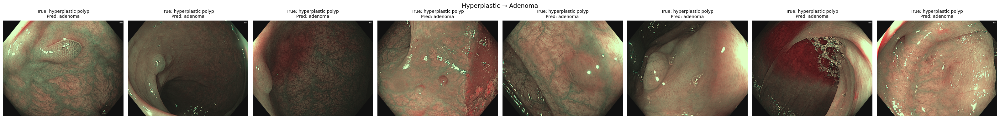

In [7]:
# Misclassified hyperplastic polyps predicted as adenoma
show_images(df_errors, title="Hyperplastic → Adenoma", n=8, true_class="hyperplastic polyp", pred_class="adenoma")

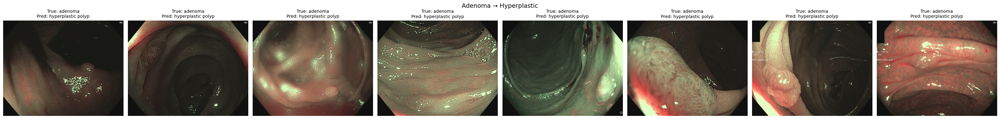

In [8]:
# Misclassified adenomas predicted as hyperplastic polyps
show_images(df_errors, title="Adenoma → Hyperplastic", n=8, true_class="adenoma", pred_class="hyperplastic polyp")

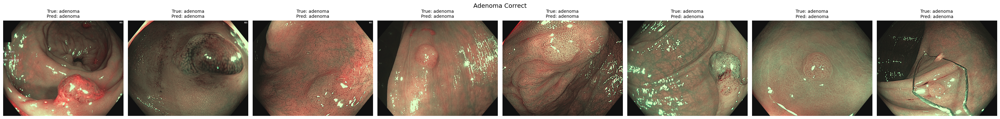

In [9]:
# Correctly classified adenomas
show_images(correct_df, title="Adenoma Correct", n=8, true_class="adenoma", pred_class="adenoma")

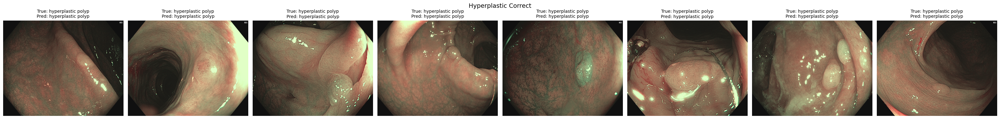

In [10]:
# Correctly classified hyperplastic polyps
show_images(correct_df, title="Hyperplastic Correct", n=8, true_class="hyperplastic polyp", pred_class="hyperplastic polyp")

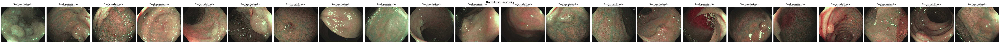

In [12]:
# Full Misclassified hyperplastic polyps predicted as adenoma
show_images(df_errors, title="Hyperplastic → Adenoma", n=22, true_class="hyperplastic polyp", pred_class="adenoma")

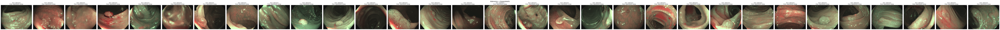

In [13]:
# Full Misclassified adenomas predicted as hyperplastic polyps
show_images(df_errors, title="Adenoma → Hyperplastic", n=31, true_class="adenoma", pred_class="hyperplastic polyp")